In [1]:
import torch
import torchvision
from torchvision.transforms import Normalize, Resize, ToTensor, Compose
from PIL import Image
from torchvision.transforms import ToPILImage
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
import os
from tqdm import tqdm
from transformers import ViTImageProcessor, ViTForImageClassification
from transformers import TrainingArguments, Trainer
from datasets import load_dataset
import numpy as np
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

/home/rahi/miniconda3/envs/vit/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Device configuration
torch.cuda.empty_cache()
device = torch.device("cuda" if torch.cuda.is_available() else "mps")
print(f"Device: {device}")

Device: cuda


In [3]:
dataset_path = "/home/rahi/Code/vit_torch/datasets/Fast Food Classification V2"

train_path = os.path.join(dataset_path, "Train")
test_path = os.path.join(dataset_path, "Test")
valid_path = os.path.join(dataset_path, "Valid")

# Define image transformations (resize, normalization, etc.)
transform = Compose([
    Resize((224, 224)),
    ToTensor(),
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), 
])

# Load the dataset
train_dataset = torchvision.datasets.ImageFolder(root=train_path, transform=transform)
test_dataset = torchvision.datasets.ImageFolder(root=test_path, transform=transform)
valid_dataset = torchvision.datasets.ImageFolder(root=valid_path, transform=transform)

# Define the data loaders
train_loader = DataLoader(dataset=train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=32, shuffle=False)
valid_loader = DataLoader(dataset=valid_dataset, batch_size=32, shuffle=False)


# Get class names (same for all datasets)
class_names = train_dataset.classes
print("Classes:", class_names)

# Example: Iterate through the train DataLoader
for images, labels in train_loader:
    print("Batch of images shape:", images.shape)
    print("Batch of labels:", labels)
    break  # Only process one batch for demonstration

Classes: ['Baked Potato', 'Burger', 'Crispy Chicken', 'Donut', 'Fries', 'Hot Dog', 'Pizza', 'Sandwich', 'Taco', 'Taquito']
Batch of images shape: torch.Size([32, 3, 224, 224])
Batch of labels: tensor([8, 4, 9, 8, 8, 0, 5, 4, 9, 7, 2, 2, 3, 3, 9, 3, 0, 5, 9, 7, 3, 8, 3, 5,
        2, 1, 2, 3, 4, 4, 1, 4])


In [ ]:
model_name = "google/vit-base-patch16-224"
model = ViTForImageClassification.from_pretrained(model_name, num_labels=10, ignore_mismatched_sizes=True)
model.to(device)
# Show the model architecture
# model.config
# model parameters
print(model.state_dict())

model_state_dict_path = "/home/rahi/Code/vit_torch/models/vit_fast_food_classifier.pth"
model.load_state_dict(torch.load(model_state_dict_path))
print(model.state_dict())
# for name, param in model.named_parameters():
#     print(f"Layer: {name}, Shape: {param.shape}")


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized because the shapes did not match:
- classifier.bias: found shape torch.Size([1000]) in the checkpoint and torch.Size([10]) in the model instantiated
- classifier.weight: found shape torch.Size([1000, 768]) in the checkpoint and torch.Size([10, 768]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


OrderedDict({'vit.embeddings.cls_token': tensor([[[ 9.8962e-03,  1.4689e-02, -2.6690e-01, -5.8776e-04,  4.0510e-01,
           5.3885e-02, -2.2178e-02,  2.3369e-02,  4.0966e-02, -2.1950e-01,
           3.1851e-04, -1.1463e-02, -1.3613e-02,  1.0975e-03, -1.2994e-02,
          -7.2687e-03,  7.6848e-04,  5.7467e-02,  3.0104e-02, -6.2324e-03,
          -4.9313e-02,  5.0945e-03, -2.9701e-03, -1.9993e-02,  1.9781e-03,
           5.4685e-02,  4.0473e-03, -3.8214e-03,  3.6615e-02, -2.2641e-02,
           4.3593e-04,  2.3658e-02, -1.8996e-02,  1.7957e-02,  1.8261e-02,
           4.6318e-03,  5.1867e-02,  2.9562e-04, -5.8164e-03, -1.2062e-02,
           3.7889e-03, -9.2025e-04,  1.9424e-02,  1.3673e-02,  4.5668e-02,
           4.3681e-01, -1.1325e-02,  2.7734e-04,  3.6051e-02, -1.1955e-03,
          -3.1415e-03, -3.4800e-02,  7.8660e-03,  9.3829e-04,  2.2359e-02,
          -1.2542e-02, -2.9033e-02, -6.6412e-03,  8.0147e-03, -6.5374e-02,
          -6.4394e-03,  6.8283e-03,  1.0331e-02,  3.1159e-0

/tmp/ipykernel_37289/1998190091.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_state_dict_path))


OrderedDict({'vit.embeddings.cls_token': tensor([[[ 1.3626e-02,  1.7690e-02, -2.7329e-01, -1.3835e-03,  4.0500e-01,
           5.4145e-02, -1.9653e-02,  2.2561e-02,  3.6042e-02, -2.2201e-01,
           2.3990e-05, -1.0746e-02, -1.0857e-02,  4.3753e-04, -1.0911e-02,
          -6.2582e-03,  3.8703e-03,  5.4061e-02,  3.2119e-02, -8.8811e-03,
          -5.1743e-02,  2.8657e-03, -3.0727e-03, -2.0432e-02,  5.7708e-03,
           5.1657e-02,  1.6968e-03, -2.4504e-03,  3.4294e-02, -2.3270e-02,
           2.6164e-03,  2.4642e-02, -1.7070e-02,  2.4090e-02,  1.8878e-02,
           7.7705e-03,  5.1115e-02, -7.1145e-03, -2.1686e-03, -1.2697e-02,
           7.3139e-04,  4.9477e-03,  1.7539e-02,  1.1223e-02,  4.0018e-02,
           4.3518e-01, -7.3016e-03, -3.6986e-03,  3.3845e-02,  2.1213e-03,
          -4.3321e-03, -3.1049e-02,  7.0945e-03,  7.8627e-04,  2.4205e-02,
          -9.2222e-03, -2.8925e-02, -6.4784e-03,  5.4515e-03, -6.5996e-02,
          -8.7650e-03,  3.7397e-04,  1.5192e-02,  4.0831e-0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4110641].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].
Clipping i

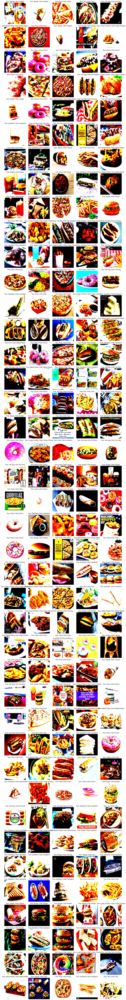

In [10]:
# Show predictions on the test set with the trained model and images randomly selected

def show_predictions(model, data_loader, class_names, n_images=5):
    model.eval()  # Ensure model is in evaluation mode
    
    # Randomly select indices for the images to show
    indices = np.random.choice(len(data_loader.dataset), n_images, replace=False)
    
    # Define the number of rows and columns based on n_images
    ncols = 5  # Number of columns
    nrows = (n_images + ncols - 1) // ncols  # Compute rows needed to display n_images
    
    # Adjust the figsize to keep images from being compacted
    figsize = (ncols * 3, nrows * 3)  # Size of the plot: 3x3 inches per image
    
    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
    axes = axes.flatten()  # Flatten the axes for easy iteration
    
    # Loop through the selected indices and plot the images and predictions
    for i, index in enumerate(indices):
        image, label = data_loader.dataset[index]  # Get the image and label
        
        # Move the image and label to the same device as the model
        image = image.unsqueeze(0).to(device)  # Add batch dimension and move to device
        
        # Predict class label with model
        with torch.no_grad():  # No need to track gradients for inference
            outputs = model(image)
        
        # Get the predicted class (using torch.max to get the class with the highest probability)
        predicted_label = class_names[outputs.logits.argmax(1).item()]  # .item() to get a Python scalar
        
        # Move image back to CPU and convert to NumPy for plotting
        image = image.cpu().squeeze(0).permute(1, 2, 0).numpy()  # Remove batch dimension, change channel order, and convert to NumPy
        
        # Plot the image on the corresponding axis
        axes[i].imshow(image)
        axes[i].set_title(f"True: {class_names[label]}, Pred: {predicted_label}")  # Use label directly, no need for item()
        axes[i].axis("off")
    
    # Hide any unused axes (in case n_images isn't a perfect multiple of ncols)
    for j in range(i + 1, len(axes)):
        axes[j].axis("off")
    
    plt.tight_layout()
    plt.show()


show_predictions(model, test_loader, class_names, n_images=205)

In [9]:
# Check the accuracy on the test set
def check_accuracy(model, data_loader):
    model.eval()  # Set model to evaluation mode
    correct_predictions = 0
    num_samples = 0
    
    # Tell PyTorch not to worry about constructing the computational graph during the forward pass (since we are only evaluating)
    with torch.no_grad():
        for images, labels in data_loader:
            images = images.to(device)
            labels = labels.to(device)
            
            # Get predicted logits from the model
            outputs = model(images)
            
            # Match actual labels to the predicted classes
            _, predictions = outputs.logits.max(1)
            correct_predictions += (predictions == labels).sum()
            num_samples += predictions.size(0)
    
    model.train()  # Set model back to training mode
    accuracy = float(correct_predictions) / num_samples
    return accuracy

test_accuracy = check_accuracy(model, test_loader)
print(f"Test accuracy: {test_accuracy:.2f}")

Test accuracy: 0.93


In [6]:
# Model parameters (number of trainable parameters)
n_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters:", n_parameters)

Number of trainable parameters: 85806346


In [7]:
# # Export the model
# sample_input = torch.randn(1, 3, 224, 224).to(device)
# torch.onnx.export(model, sample_input, "models/vit_fast_food_classifier.onnx", verbose=False, export_params=True)

In [8]:
# import onnx

# # Load the ONNX model
# onnx_model = onnx.load("models/vit_fast_food_classifier.onnx")

# # Check the ONNX model
# onnx.checker.check_model(onnx_model)

# # Print the ONNX model parameters
# print("Model inputs:", [input.name for input in onnx_model.graph.input])